# Further fine tuning on small objects

After inspecting the results of the retinaNet finetuned on the TACO data set it was clear that most of the false negatives were small objects.
This notebook is my first attempt at improving the performance of the model.  
To do this, I will:
- load the model saved from the [previous notebook](https://www.kaggle.com/code/mauroabidalcarrer/model-training?scriptVersionId=160412521).
- filter out the images that don't contain the small objects.
- fit the model only on this data subset.

## Imports

In [1]:
# Install KerasCV and PyCOCOTools metrics
! pip install -q pycocotools git+https://github.com/keras-team/keras-cv@v0.6.4

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
print("tensorflow:", tf.__version__)
import keras_cv
from keras_cv import bounding_box
from keras_cv import visualization
from keras.callbacks import LambdaCallback
from tensorflow.keras.models import Model

print("keras_cv:", keras_cv.__version__)
device_name = tf.test.gpu_device_name()

if "GPU" in device_name:
    print(f'Found GPU at: {device_name}')
else:
    print('GPU not found.')

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


tensorflow: 2.13.0
Using TensorFlow backend
keras_cv: 0.6.4
Found GPU at: /device:GPU:0


# Utils

In [3]:
def visualize_dataset(inputs, value_range, rows, cols, bounding_box_format):
    inputs = next(iter(inputs.take(1)))
    images, bounding_boxes = inputs["images"], inputs["bounding_boxes"]
    visualization.plot_bounding_box_gallery(
        images,
        value_range=value_range,
        rows=rows,
        cols=cols,
        y_true=bounding_boxes,
        scale=5,
        font_scale=0.7,
        bounding_box_format=bounding_box_format,
        class_mapping=CLASS_MAPPING,
    )

def visualize_detections(model, dataset, bounding_box_format, rows=2, cols=2):
    images, y_true = next(iter(dataset.take(1)))
    y_pred = model.predict(images)
    y_pred = bounding_box.to_ragged(y_pred)
    visualization.plot_bounding_box_gallery(
        images,
        value_range=(0, 255),
        bounding_box_format=bounding_box_format,
        y_true=y_true,
        y_pred=y_pred,
        scale=4,
        rows=rows,
        cols=cols,
        show=True,
        font_scale=0.7,
        class_mapping=CLASS_MAPPING,
    )
    

In [4]:
CLASS_MAPPING = {
    1: "Aluminium foil",
    2: "Bottle",
    3: "Bottle cap",
    4: "Broken glass",
    5: "Can",
    6: "Carton",
    7: "Cigarette",
    8: "Cup",
    9: "Lid",
    10: "Other litter",
    11: "Other plastic",
    12: "Paper",
    13: "Plastic bag - wrapper",
    14: "Plastic container",
    15: "Pop tab",
    16: "Straw",
    17: "Styrofoam piece",
    18: "Unlabeled litter",
}

# Loading Data

In [5]:
train_tfrecord_file = '/kaggle/input/taco-tfrecord/Train_litter.tfrecord'
val_tfrecord_file = '/kaggle/input/taco-tfrecord/Test_litter.tfrecord'

# Create a TFRecordDataset
train_dataset = tf.data.TFRecordDataset([train_tfrecord_file])
val_dataset = tf.data.TFRecordDataset([val_tfrecord_file])

In [6]:
def parse_tfrecord_fn(example):
    feature_description = {
        'image/encoded': tf.io.FixedLenFeature([], tf.string),
        'image/height': tf.io.FixedLenFeature([], tf.int64),
        'image/width': tf.io.FixedLenFeature([], tf.int64),
        'image/object/bbox/xmin': tf.io.VarLenFeature(tf.float32),
        'image/object/bbox/xmax': tf.io.VarLenFeature(tf.float32),
        'image/object/bbox/ymin': tf.io.VarLenFeature(tf.float32),
        'image/object/bbox/ymax': tf.io.VarLenFeature(tf.float32),
        'image/object/class/label': tf.io.VarLenFeature(tf.int64),
    }
    
    parsed_example = tf.io.parse_single_example(example, feature_description)

    # Decode the JPEG image and normalize the pixel values to the [0, 1] range.
    img = tf.image.decode_jpeg(parsed_example['image/encoded'], channels=3) # Returned as uint8
    # Normalize the pixel values to [0, 256]
    img = tf.image.convert_image_dtype(img, tf.uint8)

    # Get the bounding box coordinates and class labels.
    xmin = tf.sparse.to_dense(parsed_example['image/object/bbox/xmin'])
    xmax = tf.sparse.to_dense(parsed_example['image/object/bbox/xmax'])
    ymin = tf.sparse.to_dense(parsed_example['image/object/bbox/ymin'])
    ymax = tf.sparse.to_dense(parsed_example['image/object/bbox/ymax'])
    labels = tf.sparse.to_dense(parsed_example['image/object/class/label'])

    # Stack the bounding box coordinates to create a [num_boxes, 4] tensor.
    rel_boxes = tf.stack([xmin, ymin, xmax, ymax], axis=-1)
    boxes = keras_cv.bounding_box.convert_format(rel_boxes, source='rel_xyxy', target='xyxy', images=img)

    # Create the final dictionary.
    image_dataset = {
        'images': img,
        'bounding_boxes': {
            'classes': labels,
            'boxes': boxes
        }
    }

    return image_dataset

train_dataset = train_dataset.map(parse_tfrecord_fn)
val_dataset = val_dataset.map(parse_tfrecord_fn)

In [7]:
# Batching
BATCH_SIZE = 32
# Adding autotune for pre-fetching
AUTOTUNE = tf.data.experimental.AUTOTUNE
# Other constants
NUM_ROWS = 4
NUM_COLS = 8
IMG_SIZE = 416
BBOX_FORMAT = "xyxy"

train_dataset = train_dataset.ragged_batch(BATCH_SIZE).prefetch(buffer_size=AUTOTUNE)
val_dataset = val_dataset.ragged_batch(BATCH_SIZE).prefetch(buffer_size=AUTOTUNE)

augmenter = keras.Sequential(
    [
        keras_cv.layers.JitteredResize(
            target_size=(IMG_SIZE, IMG_SIZE), scale_factor=(0.8, 1.25), bounding_box_format=BBOX_FORMAT
        ),
        keras_cv.layers.RandomFlip(mode="horizontal_and_vertical", bounding_box_format=BBOX_FORMAT),
        keras_cv.layers.RandomRotation(factor=0.25, bounding_box_format=BBOX_FORMAT),
        keras_cv.layers.RandomSaturation(factor=(0.4, 0.6)),
        keras_cv.layers.RandomHue(factor=0.2, value_range=[0,255])
    ]
)

train_dataset = train_dataset.map(augmenter, num_parallel_calls=tf.data.AUTOTUNE)

# Resize and pad images
inference_resizing = keras_cv.layers.Resizing(
    IMG_SIZE, IMG_SIZE, pad_to_aspect_ratio=True, bounding_box_format=BBOX_FORMAT
)

val_dataset = val_dataset.map(inference_resizing, num_parallel_calls=tf.data.AUTOTUNE)

# Filter out big objects

### Visualize the training dataset before filtering out small objects

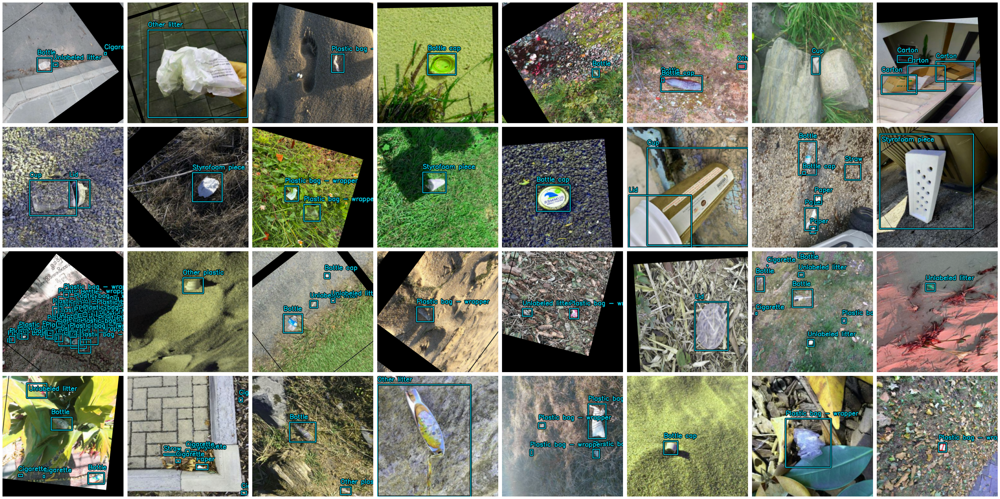

In [8]:
# Visualize training set
visualize_dataset(
    train_dataset, bounding_box_format=BBOX_FORMAT, value_range=(0, 255), rows=NUM_ROWS, cols=NUM_COLS
)

In [9]:
def dict_to_tuple(inputs):
    return inputs["images"], bounding_box.to_dense(
        inputs["bounding_boxes"], max_boxes=32
    )
train_dataset = train_dataset.map(dict_to_tuple, num_parallel_calls=tf.data.AUTOTUNE)
val_dataset = val_dataset.map(dict_to_tuple, num_parallel_calls=tf.data.AUTOTUNE)

In [10]:
tf.data.experimental.enable_debug_mode()

def calculate_area(bbox):
    ymin, xmin, ymax, xmax = tf.unstack(bbox, axis=-1)
    return (xmax - xmin) * (ymax - ymin)

def filter_by_area(image_element, area_threshold):
    bboxes = image_element['boxes']
    keep_image = False
    for bbox in bboxes:  # Iterate over each bbox in the image
        area = calculate_area(bbox)
        keep_box = area <= area_threshold and area > 0
        #tf.print(f"Area of bbox: {area}, keeping box: {keep_box}")  # Print the area of the current bbox
        if keep_box:
            keep_image = True
            break 
    
    #tf,print(f"keeping image:{keep_image}\n")
    return keep_image

def filter_dataset(dataset):
    return dataset.filter(lambda image, bboxes: filter_by_area(bboxes, area_threshold))

# Usage with the dataset
area_threshold = 1000
train_dataset = train_dataset.unbatch()  # Unbatch the dataset
train_dataset = train_dataset.apply(filter_dataset)
train_dataset = train_dataset.batch(BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)

# Creating RetinaNet Model

In [11]:
base_lr = 0.0001
# including a global_clipnorm is extremely important in object detection tasks
optimizer_Adam = tf.keras.optimizers.Adam(
    learning_rate=base_lr,
    global_clipnorm=10.0
)

coco_metrics = keras_cv.metrics.BoxCOCOMetrics(
    bounding_box_format=BBOX_FORMAT, evaluate_freq=5
)

class VisualizeDetections(keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs):
        if (epoch+1)%5==0:
            visualize_detections(
                self.model, bounding_box_format=BBOX_FORMAT, dataset=val_dataset, rows=NUM_ROWS, cols=NUM_COLS
            )

checkpoint_path="best-custom-model.h5"

callbacks_list = [
    # Conducting early stopping to stop after 6 epochs of non-improving validation loss
    keras.callbacks.EarlyStopping(
        monitor="val_loss",
        patience=6,
    ),
    
    # Saving the best model
    keras.callbacks.ModelCheckpoint(
        filepath=checkpoint_path,
        monitor="val_loss",
        mode="min",
        save_best_only=True,
        save_weights_only=False,
        save_freq='epoch',
    ),
    
    # Custom metrics printing after each epoch
    tf.keras.callbacks.LambdaCallback(
    on_epoch_end=lambda epoch, logs: 
        print(f"\nEpoch #{epoch+1} \n" +
              f"Loss: {logs['loss']:.4f} \n" + 
              f"mAP: {logs['MaP']:.4f} \n" + 
              f"Validation Loss: {logs['val_loss']:.4f} \n" + 
              f"Validation mAP: {logs['val_MaP']:.4f} \n") 
    ),
    
    # Visualizing results after each n epoch
    VisualizeDetections()
]

# Building a RetinaNet model
def create_model():
    model = keras_cv.models.RetinaNet.from_preset(
        #"yolo_v8_m_backbone_coco",
        #"mobilenet_v3_small_imagenet",
        "yolo_v8_xs_backbone_coco", # I ended up using this backbone model as it is the fastet to train.
        num_classes=len(CLASS_MAPPING),
        bounding_box_format=BBOX_FORMAT
    )
    return model

model = create_model()


# Customizing non-max supression of model prediction.
model.prediction_decoder = keras_cv.layers.MultiClassNonMaxSuppression(
    bounding_box_format = BBOX_FORMAT,
    from_logits=True,
    iou_threshold=0.5,
    confidence_threshold=0.5,
)

# Using focal classification loss and smoothl1 box loss with coco metrics
model.compile(
    classification_loss="focal",
    box_loss="smoothl1",
    optimizer=optimizer_Adam,
    #metrics=[coco_metrics]
)

5347160/5347160 [==============================] - 1s 0us/step


## Comparing fitness before and after training

1/1 [==============================] - 6s 6s/step


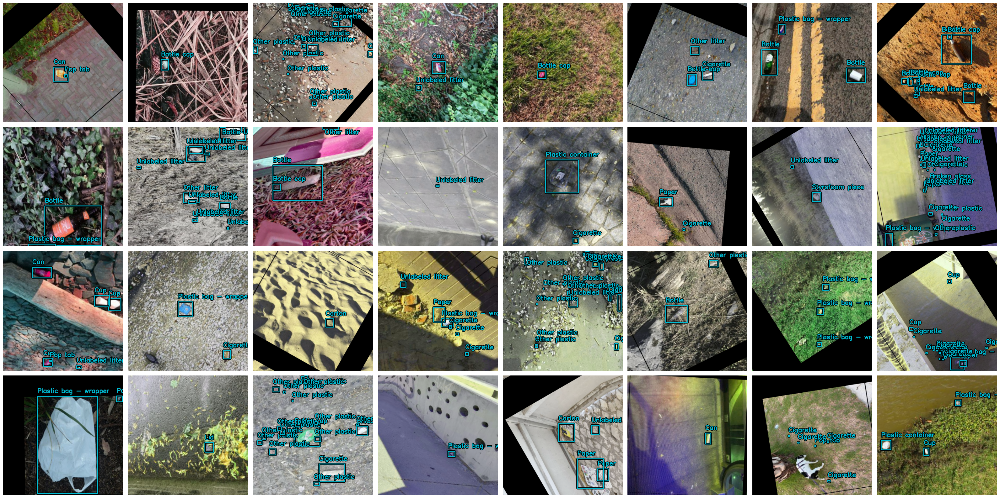

In [12]:
visualize_detections(model, dataset=train_dataset.skip(1), bounding_box_format=BBOX_FORMAT, rows=NUM_ROWS, cols=NUM_COLS)

In [13]:
# For some reason, the filtered dataset woul cause issues when calling the fit method.
# The model some time trains for 2 and some other time 4 epochs.
# As a quick work around I simply encapsulated the method call in a for loop.
# I did this instead of fixing the root problem as I don't know if this will be usefull yet.
# In case this method actually improves performance I'll fix the root problem.
# For now, I don't want to spend time on a solution that I might throw away.

for _ in range(5):
    history = model.fit(
        train_dataset,
        validation_data=val_dataset,
        epochs=5,
        verbose=1,
    )

Epoch 1/5
61/61 [==============================] - 220s 3s/step - loss: 1.3075 - box_loss: 0.5265 - classification_loss: 0.7810 - percent_boxes_matched_with_anchor: 0.8614 - val_loss: 1.2157 - val_box_loss: 0.5150 - val_classification_loss: 0.7007 - val_percent_boxes_matched_with_anchor: 0.8881
Epoch 2/5
61/61 [==============================] - 181s 3s/step - loss: 0.9796 - box_loss: 0.3769 - classification_loss: 0.6026 - percent_boxes_matched_with_anchor: 0.8609 - val_loss: 1.1299 - val_box_loss: 0.4516 - val_classification_loss: 0.6783 - val_percent_boxes_matched_with_anchor: 0.8881
Epoch 3/5
61/61 [==============================] - 179s 3s/step - loss: 0.9195 - box_loss: 0.3475 - classification_loss: 0.5720 - percent_boxes_matched_with_anchor: 0.8611 - val_loss: 1.0876 - val_box_loss: 0.4283 - val_classification_loss: 0.6593 - val_percent_boxes_matched_with_anchor: 0.8881
Epoch 4/5
61/61 [==============================] - 179s 3s/step - loss: 0.8766 - box_loss: 0.3352 - classificati

## Testing the model

1/1 [==============================] - 0s 246ms/step


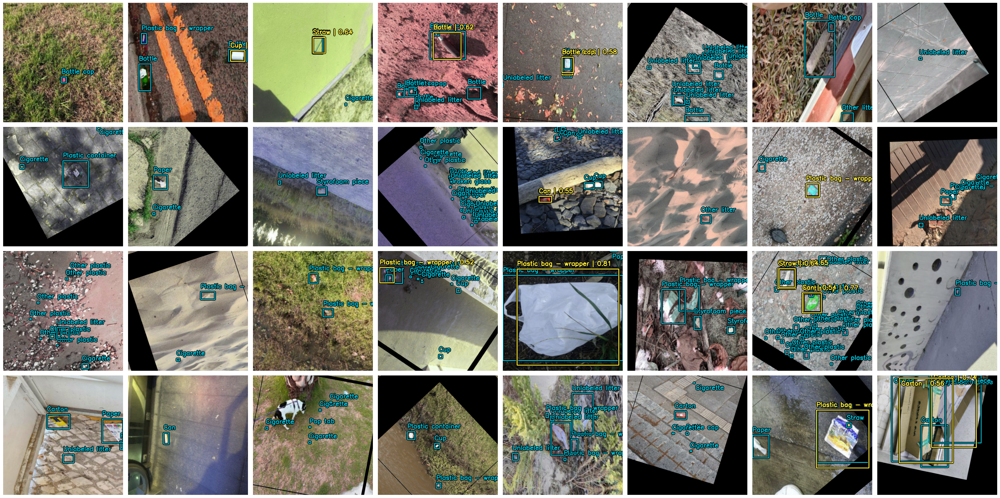

In [15]:
visualize_detections(model, dataset=train_dataset.skip(1), bounding_box_format=BBOX_FORMAT, rows=NUM_ROWS, cols=NUM_COLS)

## Save Model

In [16]:
for i in range(len(model.weights)):
    model.weights[i]._handle_name = model.weights[i].name + "_" + str(i)

model.save_weights("best-custom-model.h5")

## Conclusion

Looking at those samples and their corresponding predictions, we can see that:
- Some annotations are just too small for the 416 pixels images.
- Some annotation seem incorrect, we can see boxes that do not encapsulate anything.
- The model doesn't seem to have learned to recognize the small objects.


From these keypoints I could:
- Filter out images that contain objects that are too small to be recognized
- Fine tune the model for more epochs and/or modify the training hyperparameters
- Increase the resolution of the images